#**MUSIC GENRE CLASSIFICATION USING GTZAN DATASET:**
---------------------------------------------------
TEAM MEMBERS:

19PD09 - DHIKSHITHA A

19PD38 - SWATHI PRATHAA P


In [139]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#**DATA DESCRIPTION :**
- **Genres_original** - A collection of 10 genres with 100 audio files each, all having a length of 30 seconds (the famous GTZAN dataset, the MNIST of sounds)


# **IMPORT LIBRARIES**

In [140]:
!pip install librosa
!pip install catboost

In [141]:
import matplotlib.pyplot as plt
import librosa
import librosa.display
import IPython.display as ipd
from scipy.io import wavfile as wav
import catboost as cb
import pandas as pd
import os
import audioread
import csv
import pandas as pd
import os
from tqdm import tqdm
import numpy as np
import librosa
import sklearn
from scipy.stats import kurtosis
from scipy.stats import skew
import numpy as np
import seaborn as sns
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics.pairwise import cosine_similarity
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.metrics import classification_report
from yellowbrick.classifier import ROCAUC
import warnings
warnings.filterwarnings('ignore')



> The below code displays the various genres in our audio file.



In [142]:
path = '/content/drive/MyDrive/ColabNotebooks/SUL Package/Gtzan'
print(list(os.listdir(f'{path}/genres_original/')))

['hiphop', 'rock', 'disco', 'blues', 'pop', 'classical', 'reggae', 'country', 'metal', 'data.csv']


# ***EDA - AUDIO FILES***



> The waveplot plots the different waveplots for the different genres.



## 1.**BLUES**

In [143]:
sound, sample_rate = librosa.load(f'{path}/genres_original/blues/blues.00000.wav')
ipd.Audio(sound, rate=sample_rate)

In [144]:
array_len = sound.shape
print('Sound shape:', array_len)
print('Sample Rate (Hz):', sample_rate)
print('Check Len of Audio:', array_len[0] / sample_rate)

Sound shape: (661794,)
Sample Rate (Hz): 22050
Check Len of Audio: 30.013333333333332


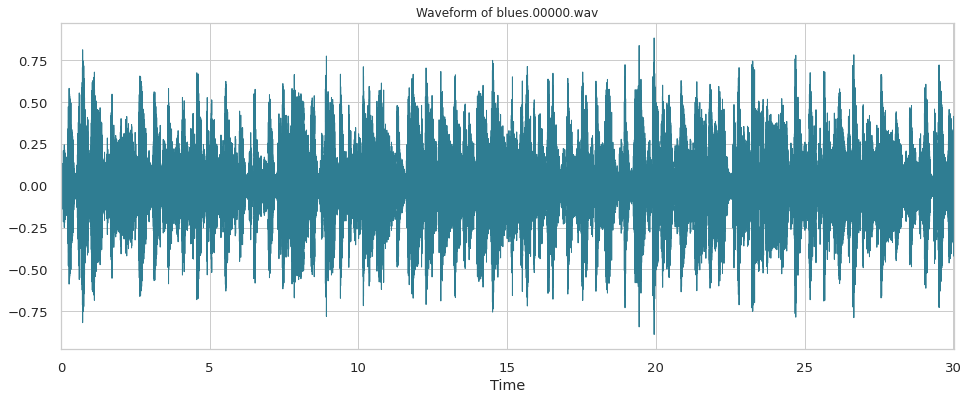

In [145]:
plt.figure(figsize=(16, 6))
librosa.display.waveplot(y=sound, sr=sample_rate, color="#2f7d92ff")
plt.title("Waveform of blues.00000.wav", fontsize=12)  # Classical music are highly dynamic.
plt.show()

##**2.HIPHOP**

In [146]:
sound, sample_rate = librosa.load(f'{path}/genres_original/hiphop/hiphop.00000.wav')
ipd.Audio(sound, rate=sample_rate)

In [147]:
array_len = sound.shape
print('Sound shape:', array_len)
print('Sample Rate (Hz):', sample_rate)
print('Check Len of Audio:', array_len[0] / sample_rate)

Sound shape: (661504,)
Sample Rate (Hz): 22050
Check Len of Audio: 30.00018140589569


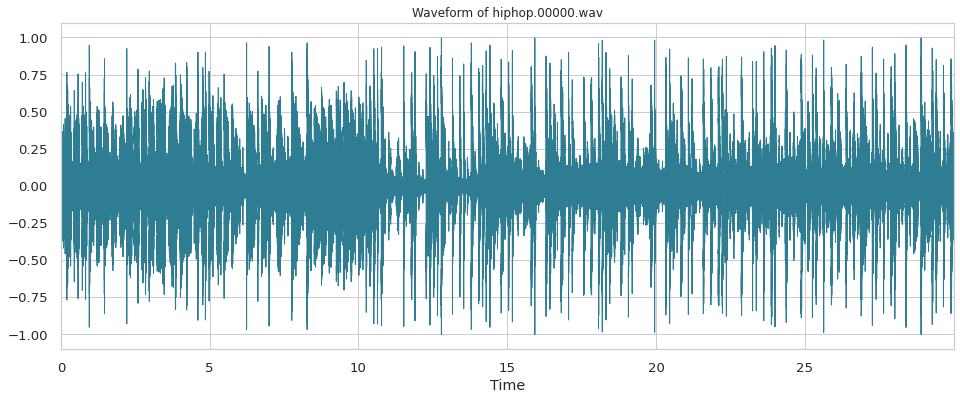

In [148]:
plt.figure(figsize=(16, 6))
librosa.display.waveplot(y=sound, sr=sample_rate, color="#2f7d92ff")
plt.title("Waveform of hiphop.00000.wav", fontsize=12)  # Classical music are highly dynamic.
plt.show()

##**3.POP**

In [149]:
sound, sample_rate = librosa.load(f'{path}/genres_original/pop/pop.00000.wav')
ipd.Audio(sound, rate=sample_rate)

In [150]:
array_len = sound.shape
print('Sound shape:', array_len)
print('Sample Rate (Hz):', sample_rate)
print('Check Len of Audio:', array_len[0] / sample_rate)

Sound shape: (661504,)
Sample Rate (Hz): 22050
Check Len of Audio: 30.00018140589569


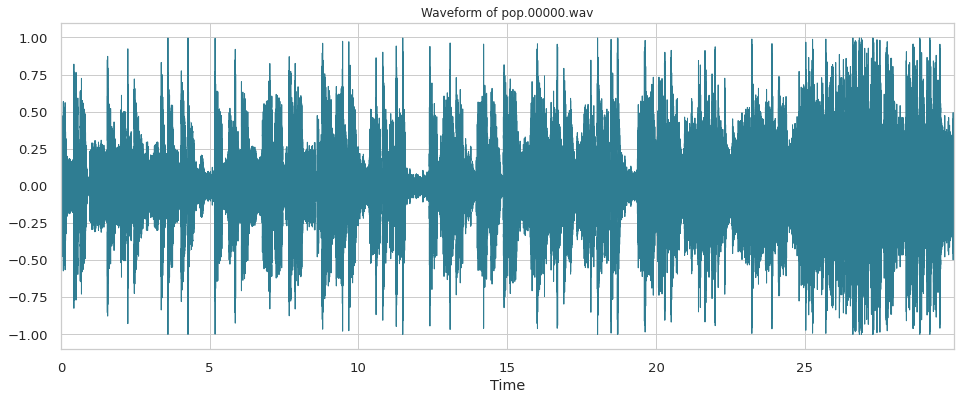

In [151]:
plt.figure(figsize=(16, 6))
librosa.display.waveplot(y=sound, sr=sample_rate, color="#2f7d92ff")
plt.title("Waveform of pop.00000.wav", fontsize=12)  # Classical music are highly dynamic.
plt.show()

##**4.CLASSICAL**

In [152]:
sound, sample_rate = librosa.load(f'{path}/genres_original/classical/classical.00000.wav')
ipd.Audio(sound, rate=sample_rate)

In [153]:
array_len = sound.shape
print('Sound shape:', array_len)
print('Sample Rate (Hz):', sample_rate)
print('Check Len of Audio:', array_len[0] / sample_rate)

Sound shape: (661794,)
Sample Rate (Hz): 22050
Check Len of Audio: 30.013333333333332


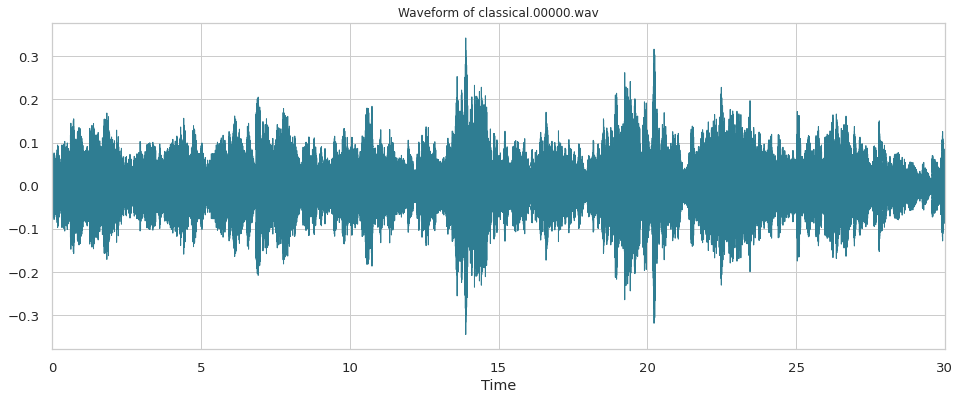

In [154]:
plt.figure(figsize=(16, 6))
librosa.display.waveplot(y=sound, sr=sample_rate, color="#2f7d92ff")
plt.title("Waveform of classical.00000.wav", fontsize=12)  # Classical music are highly dynamic.
plt.show()

## **SPECTROGRAM**



> A spectrogram is a visual way of representing the signal loudness, of a signal over time at various frequencies present in a particular waveform. Not only can one see whether there is more or less energy at, for example, 2 Hz vs 10 Hz, but one can also see how energy levels vary over time.The vertical axis represents frequencies (from 0 to 10kHz), and the horizontal axis represents the time of the clip.



In [155]:
x, sr = librosa.load('/content/drive/MyDrive/ColabNotebooks/SUL Package/Gtzan/genres_original/blues/blues.00000.wav')

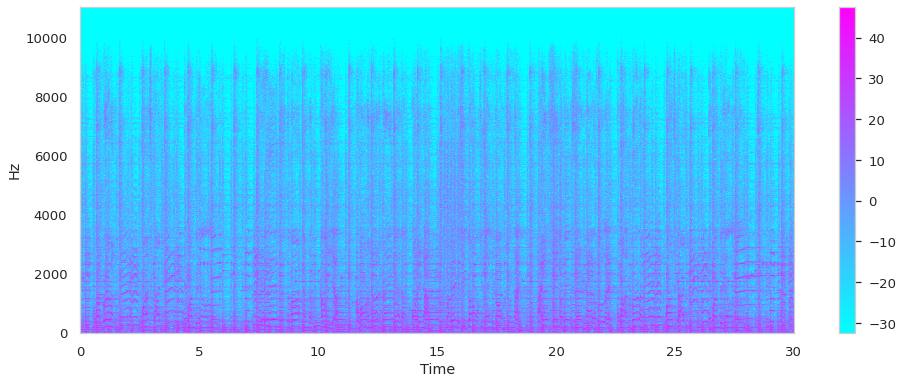

In [156]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))

# Creating the Spectogram
plt.figure(figsize = (16, 6))
librosa.display.specshow(Xdb, sr = sr, x_axis='time',hop_length=512, y_axis='hz', cmap = 'cool')
plt.colorbar()

##**MEL SPECTROGRAM**


> The Mel Scale, mathematically speaking, is the result of some non-linear transformation of the frequency scale. The Mel Spectrogram is a normal Spectrogram, but with a Mel Scale on the y axis.




In [157]:
y, sr = librosa.load('/content/drive/MyDrive/ColabNotebooks/SUL Package/Gtzan/genres_original/blues/blues.00000.wav')
audio_file, _ = librosa.effects.trim(y)

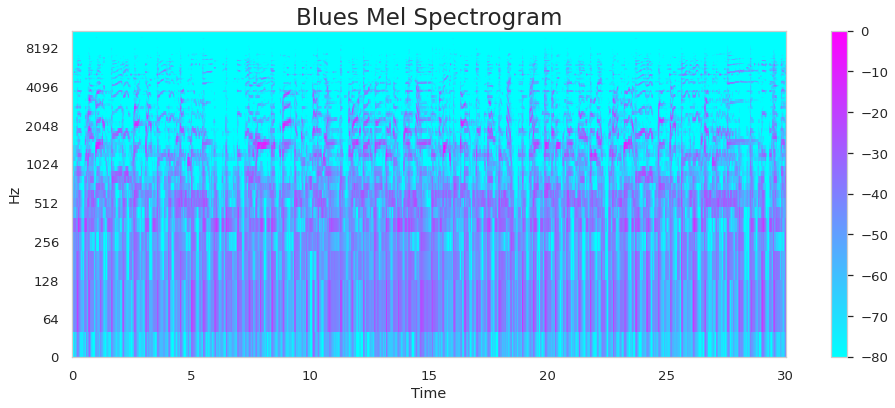

In [158]:
S = librosa.feature.melspectrogram(audio_file, sr=sr)
Xdb = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (16, 6))
librosa.display.specshow(Xdb, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log', cmap = 'cool');
plt.colorbar();
plt.title("Blues Mel Spectrogram", fontsize = 23);

##*SPECTRAL CENTROID*

> Spectral centroid indicates where the ”centre of mass” for a sound is located and is calculated as the weighted mean of the frequencies present in the sound.

In [159]:
spectral_centroids = librosa.feature.spectral_centroid(audio_file, sr=sr)[0]
print('Centroids:', spectral_centroids, '\n')
print('Shape of Spectral Centroids:', spectral_centroids.shape, '\n')

frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)

print('frames:', frames, '\n')
print('t:', t)



Centroids: [2175.02383311 2103.86995762 1955.28566681 ... 1490.45684641 1506.97560844
 1442.64520571] 

Shape of Spectral Centroids: (1293,) 

frames: range(0, 1293) 

t: [0.00000000e+00 2.32199546e-02 4.64399093e-02 ... 2.99537415e+01
 2.99769615e+01 3.00001814e+01]


In [160]:
# Function that normalizes the Sound Data
def normalize(x, axis=0):
    scaler = MinMaxScaler()
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

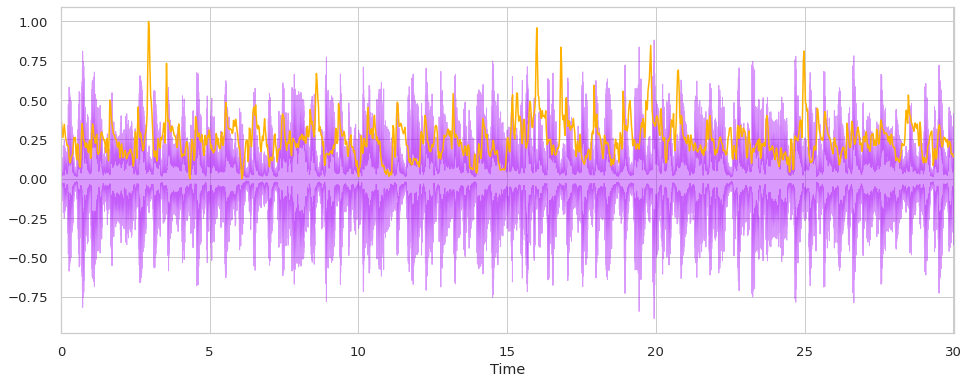

In [161]:
#Plotting the Spectral Centroid along the waveform
plt.figure(figsize = (16, 6))
librosa.display.waveplot(audio_file, sr=sr, alpha=0.4, color = '#A300F9');
plt.plot(t, normalize(spectral_centroids), color='#FFB100');

##**MEL-FREQUENCY CEPSTRAL COEFFICIENTS:**


> The Mel frequency cepstral coefficients (MFCCs) of a signal are a small set of features (usually about 10–20) which concisely describe the overall shape of a spectral envelope. It models the characteristics of the human voice.




mfccs shape: (20, 1293)


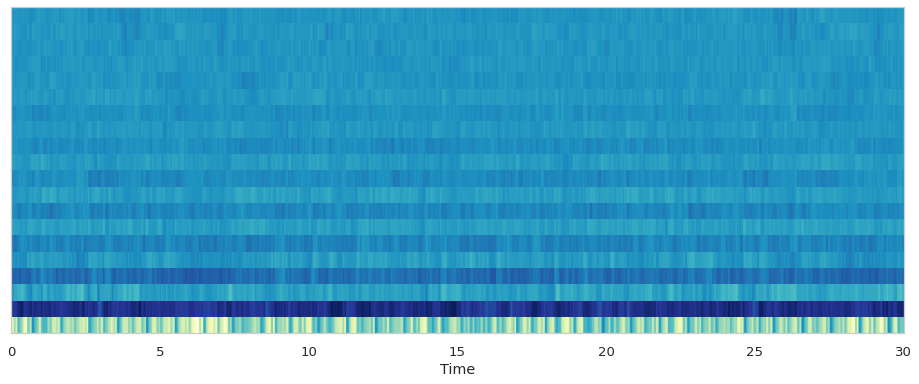

In [162]:
mfccs = librosa.feature.mfcc(audio_file, sr=sr)
print('mfccs shape:', mfccs.shape)

#Displaying  the MFCCs:
plt.figure(figsize = (16, 6))
librosa.display.specshow(mfccs, sr=sr, x_axis='time', cmap = "YlGnBu");

In [163]:
# Perform Feature Scaling
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
print('Mean:', mfccs.mean(), '\n')
print('Var:', mfccs.var())

Mean: 6.6381045e-10 

Var: 1.0


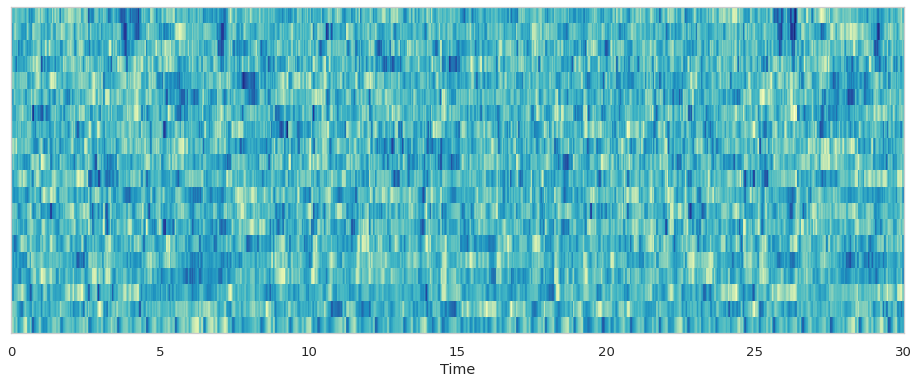

In [164]:
plt.figure(figsize = (16, 6))
librosa.display.specshow(mfccs, sr=sr, x_axis='time', cmap =  "YlGnBu");

##**CHROMA FREQUENCY**


> Chroma features are an interesting and powerful representation for music audio in which the entire spectrum is projected onto 12 bins representing the 12 distinct semitones (or chroma) of the musical octave.



Chromogram shape: (12, 133)


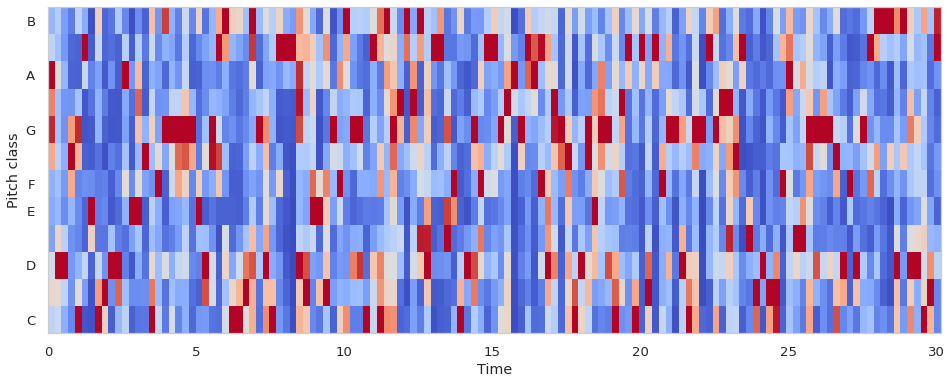

In [165]:
# Increase or decrease hop_length to change how granular you want your data to be
hop_length = 5000

# Chromogram
chromagram = librosa.feature.chroma_stft(audio_file, sr=sr, hop_length=hop_length)
print('Chromogram shape:', chromagram.shape)

plt.figure(figsize=(16, 6))
librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm');

#**FEATURE EXTRACTION**

In [166]:
def extract_features(y,sr=22050,n_fft=1024,hop_length=512):
    features = {'centroid': librosa.feature.spectral_centroid(y, sr=sr, n_fft=n_fft, hop_length=hop_length).ravel(),
                'flux': librosa.onset.onset_strength(y=y, sr=sr).ravel(),
                'rmse': librosa.feature.rms(y, frame_length=n_fft, hop_length=hop_length).ravel(),
                'zcr': librosa.feature.zero_crossing_rate(y, frame_length=n_fft, hop_length=hop_length).ravel(),
                'contrast': librosa.feature.spectral_contrast(y, sr=sr).ravel(),
                'bandwidth': librosa.feature.spectral_bandwidth(y, sr=sr, n_fft=n_fft, hop_length=hop_length).ravel(),
                'flatness': librosa.feature.spectral_flatness(y, n_fft=n_fft, hop_length=hop_length).ravel(),
                'rolloff': librosa.feature.spectral_rolloff(y, sr=sr, n_fft=n_fft, hop_length=hop_length).ravel()}

    # MFCC treatment
    mfcc = librosa.feature.mfcc(y, n_fft=n_fft, hop_length=hop_length, n_mfcc=20)
    for idx, v_mfcc in enumerate(mfcc):
        features['mfcc_{}'.format(idx)] = v_mfcc.ravel()

    # Get statistics from the vectors
    def get_feature_stats(features):
        result = {}
        for k, v in features.items():
            result['{}_mean'.format(k)] = np.mean(v)
            result['{}_var'.format(k)] = np.var(v)
        return result

    dict_agg_features = get_feature_stats(features)
    dict_agg_features['tempo'] = librosa.beat.tempo(y=y,sr=sr,hop_length=hop_length)[0]

    return dict_agg_features

def make_data():
    arr_features=[]
    os.chdir('/content/drive/MyDrive/ColabNotebooks/SUL Package/Gtzan/genres_original')
    genres = 'blues classical country disco hiphop metal pop reggae rock'.split()
    for idx,genre in tqdm(enumerate(genres),total=len(genres)):
        for fname in os.listdir(genre):
            y, sr = librosa.load(genre+'/'+fname, duration=3)
            dict_features=extract_features(y=y,sr=sr)
            dict_features['label']=idx
            arr_features.append(dict_features)

    df=pd.DataFrame(data=arr_features)
    print(df.head())
    print(df.shape)
    os.chdir('..')
    os.chdir('..')
    df.to_csv('feature_3_sec.csv',index=False)

#Call the function
make_data()

100%|██████████| 9/9 [12:04<00:00, 80.55s/it]


   centroid_mean   centroid_var  flux_mean  ...  mfcc_19_var       tempo  label
0    1703.827120  177067.278777   1.444530  ...    54.122360  129.199219      0
1    1458.150460  156547.591746   1.673339  ...    78.777130  135.999178      0
2     920.576478   25981.533001   1.299132  ...    46.399536   89.102909      0
3    1378.403047   99181.203313   1.563311  ...    65.323051   89.102909      0
4    1674.669673  257222.956199   1.443774  ...    41.585140  161.499023      0

[5 rows x 58 columns]
(900, 58)


#**LOAD DATASET:**


In [167]:
df = pd.read_csv('/content/drive/MyDrive/ColabNotebooks/SUL Package/Gtzan/features_3_sec.csv')
df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,zero_crossing_rate_mean,zero_crossing_rate_var,harmony_mean,harmony_var,perceptr_mean,perceptr_var,tempo,mfcc1_mean,mfcc1_var,mfcc2_mean,mfcc2_var,mfcc3_mean,mfcc3_var,mfcc4_mean,mfcc4_var,mfcc5_mean,mfcc5_var,mfcc6_mean,mfcc6_var,mfcc7_mean,mfcc7_var,mfcc8_mean,mfcc8_var,mfcc9_mean,mfcc9_var,mfcc10_mean,mfcc10_var,mfcc11_mean,mfcc11_var,mfcc12_mean,mfcc12_var,mfcc13_mean,mfcc13_var,mfcc14_mean,mfcc14_var,mfcc15_mean,mfcc15_var,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,3714.560359,1.080790e+06,0.081851,0.000558,-0.000078,0.008354,-0.000068,0.005535,129.199219,-118.627914,2440.286621,125.083626,260.956909,-23.443724,364.081726,41.321484,181.694855,-5.976108,152.963135,20.115141,75.652298,-16.045410,40.227104,17.855198,84.320282,-14.633434,83.437233,10.270527,97.001335,-9.708279,66.669891,10.183875,45.103611,-4.681614,34.169498,8.417439,48.269444,-7.233477,42.770947,-2.853603,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,3869.682242,6.722448e+05,0.087173,0.001030,-0.000099,0.004950,-0.000103,0.004854,123.046875,-125.590706,2038.344238,122.421227,216.774185,-20.718019,231.979767,50.128387,142.700409,-11.333302,139.243118,21.385401,77.817947,-15.960796,97.364029,19.454103,57.948093,-12.465918,68.271523,17.898169,56.222176,-11.732554,54.373909,8.145000,40.662876,-7.717751,30.808521,8.397150,48.784225,-8.300493,68.584824,4.074709,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,3997.639160,7.907127e+05,0.071383,0.000425,-0.000066,0.012476,0.000065,0.004357,123.046875,-132.441940,3798.532227,115.085175,257.321289,-14.811666,192.448074,50.189293,144.166031,-0.680819,128.376892,24.650375,66.371170,-13.506104,89.319336,15.643386,55.253967,-13.216637,120.308784,10.406025,35.757862,-7.991465,47.911613,11.853963,36.569931,-4.677677,40.725075,6.571110,30.686846,-2.424750,50.313499,4.806280,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,3568.300218,9.216524e+05,0.069426,0.000304,-0.000014,0.008318,0.000018,0.005927,123.046875,-118.231087,2508.781006,132.116501,332.650574,-18.758335,109.357529,39.769306,184.693344,-13.260426,144.398224,20.468134,122.516464,-14.563448,68.937332,18.745104,74.748886,-13.755463,73.868576,12.993759,41.549564,-12.648887,58.540478,10.389314,39.102024,-4.362739,60.714748,9.156193,40.411537,-9.889441,44.666325,-1.359111,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,3469.992864,6.102111e+05,0.070095,0.000289,0.000041,0.009634,-0.000106,0.005833,123.046875,-105.968376,2118.919922,134.643646,219.562622,-19.961748,171.878754,40.171753,103.120712,-14.271939,102.651230,18.734617,79.070000,-15.619381,48.510284,19.207966,53.642956,-18.274683,95.300995,14.316693,58.821163,-5.792194,55.030254,17.045437,43.229939,-5.681399,46.515259,5.705521,24.956211,-7.986080,39.816933,2.092937,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


In [168]:
df.shape

(9990, 60)

In [169]:
df['label'].unique()

array(['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz',
       'metal', 'pop', 'reggae', 'rock'], dtype=object)

In [170]:
df.columns

Index(['filename', 'length', 'chroma_stft_mean', 'chroma_stft_var', 'rms_mean',
       'rms_var', 'spectral_centroid_mean', 'spectral_centroid_var',
       'spectral_bandwidth_mean', 'spectral_bandwidth_var', 'rolloff_mean',
       'rolloff_var', 'zero_crossing_rate_mean', 'zero_crossing_rate_var',
       'harmony_mean', 'harmony_var', 'perceptr_mean', 'perceptr_var', 'tempo',
       'mfcc1_mean', 'mfcc1_var', 'mfcc2_mean', 'mfcc2_var', 'mfcc3_mean',
       'mfcc3_var', 'mfcc4_mean', 'mfcc4_var', 'mfcc5_mean', 'mfcc5_var',
       'mfcc6_mean', 'mfcc6_var', 'mfcc7_mean', 'mfcc7_var', 'mfcc8_mean',
       'mfcc8_var', 'mfcc9_mean', 'mfcc9_var', 'mfcc10_mean', 'mfcc10_var',
       'mfcc11_mean', 'mfcc11_var', 'mfcc12_mean', 'mfcc12_var', 'mfcc13_mean',
       'mfcc13_var', 'mfcc14_mean', 'mfcc14_var', 'mfcc15_mean', 'mfcc15_var',
       'mfcc16_mean', 'mfcc16_var', 'mfcc17_mean', 'mfcc17_var', 'mfcc18_mean',
       'mfcc18_var', 'mfcc19_mean', 'mfcc19_var', 'mfcc20_mean', 'mfcc20_var',
  

In [171]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9990 entries, 0 to 9989
Data columns (total 60 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   filename                 9990 non-null   object 
 1   length                   9990 non-null   int64  
 2   chroma_stft_mean         9990 non-null   float64
 3   chroma_stft_var          9990 non-null   float64
 4   rms_mean                 9990 non-null   float64
 5   rms_var                  9990 non-null   float64
 6   spectral_centroid_mean   9990 non-null   float64
 7   spectral_centroid_var    9990 non-null   float64
 8   spectral_bandwidth_mean  9990 non-null   float64
 9   spectral_bandwidth_var   9990 non-null   float64
 10  rolloff_mean             9990 non-null   float64
 11  rolloff_var              9990 non-null   float64
 12  zero_crossing_rate_mean  9990 non-null   float64
 13  zero_crossing_rate_var   9990 non-null   float64
 14  harmony_mean            

In [172]:
df['label'].value_counts()

blues        1000
pop          1000
metal        1000
jazz         1000
reggae       1000
disco         999
rock          998
hiphop        998
classical     998
country       997
Name: label, dtype: int64

So our dataset is balanced dataset

#**EDA**

##**COUNTPLOT**

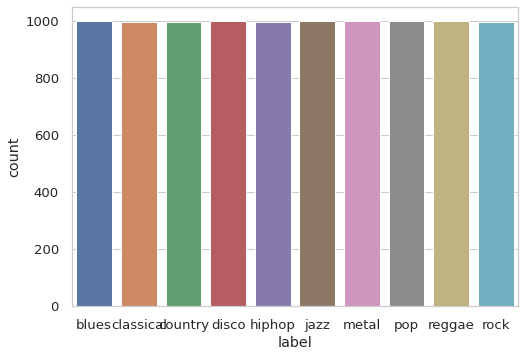

In [173]:
sns.countplot(x=df['label'])

From the above image we can infer that , our dataset is balanced.

##**CORRELATION MATRIX**

In [174]:
# Correlation matrix
df_new = df.drop(['label','length'],axis =1)
corr_mat = df_new.corr()
corr_mat

,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,zero_crossing_rate_mean,zero_crossing_rate_var,harmony_mean,harmony_var,perceptr_mean,perceptr_var,tempo,mfcc1_mean,mfcc1_var,mfcc2_mean,mfcc2_var,mfcc3_mean,mfcc3_var,mfcc4_mean,mfcc4_var,mfcc5_mean,mfcc5_var,mfcc6_mean,mfcc6_var,mfcc7_mean,mfcc7_var,mfcc8_mean,mfcc8_var,mfcc9_mean,mfcc9_var,mfcc10_mean,mfcc10_var,mfcc11_mean,mfcc11_var,mfcc12_mean,mfcc12_var,mfcc13_mean,mfcc13_var,mfcc14_mean,mfcc14_var,mfcc15_mean,mfcc15_var,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
chroma_stft_mean,1.000000,-0.443757,0.424706,0.243647,0.534670,0.251985,0.464617,0.100909,0.526881,0.138394,0.457080,0.278017,0.034305,0.216488,-0.109303,0.417177,0.019084,0.573974,0.054769,-0.513978,0.055816,0.013981,0.121196,0.213522,0.135822,0.069027,0.090913,0.342903,0.121105,0.112848,0.101439,0.423220,0.032791,0.155357,-0.016019,0.376734,-0.067534,0.108459,-0.147130,0.400529,-0.226017,-0.036171,-0.242423,0.297993,-0.265843,-0.078784,-0.270092,0.228293,-0.264815,-0.103968,-0.273841,0.168254,-0.308342,-0.062985,-0.313233,0.193666,-0.363354
chroma_stft_var,-0.443757,1.000000,-0.078410,0.251900,-0.208136,0.276964,-0.031197,0.291007,-0.141792,0.330930,-0.391281,0.138214,-0.010949,0.024139,0.072719,0.000478,-0.004419,-0.296517,0.347460,0.091757,0.326217,0.323529,0.354501,-0.194552,0.333186,0.248247,0.351826,-0.155817,0.363150,0.192922,0.343599,-0.239743,0.352686,0.126653,0.363827,-0.216207,0.337400,0.149261,0.335556,-0.263772,0.302924,0.209318,0.309993,-0.197412,0.283260,0.162830,0.285569,-0.221620,0.296099,0.111544,0.303262,-0.171744,0.295359,0.107008,0.277295,-0.173398,0.287195
rms_mean,0.424706,-0.078410,1.000000,0.553770,0.470781,0.241796,0.495142,0.085760,0.500178,0.157281,0.293745,0.217606,0.065134,0.884846,-0.012401,0.766446,0.015668,0.795000,-0.080320,-0.453606,0.033635,0.136936,0.069158,-0.034473,0.178296,0.122941,0.119419,0.072916,0.212010,0.181207,0.140892,0.134868,0.126329,0.213195,0.087181,0.144650,0.070977,0.133593,-0.012006,0.134779,-0.064247,0.043769,-0.088406,0.113960,-0.080352,0.012184,-0.088842,0.055563,-0.032953,-0.013952,-0.041470,0.087615,-0.046180,0.024552,-0.062662,0.082251,-0.103519
rms_var,0.243647,0.251900,0.553770,1.000000,0.327809,0.509235,0.383329,0.285950,0.350716,0.377474,0.143768,0.453957,0.071193,0.519717,0.100449,0.744850,-0.020418,0.296198,0.336492,-0.351508,0.355515,0.277005,0.376544,-0.215820,0.412464,0.248711,0.359285,-0.134974,0.479166,0.290245,0.356301,-0.110396,0.381793,0.301416,0.332587,-0.058046,0.297938,0.251421,0.227644,-0.066374,0.164785,0.214514,0.161973,-0.026530,0.130442,0.189566,0.116201,-0.064570,0.159390,0.144238,0.144163,-0.004785,0.102019,0.136798,0.095054,0.015085,0.073571
spectral_centroid_mean,0.534670,-0.208136,0.470781,0.327809,1.000000,0.476959,0.890382,0.021120,0.974360,0.172380,0.865487,0.579997,0.050559,0.274194,-0.004654,0.531487,0.002111,0.686196,-0.061331,-0.931435,0.085022,0.195977,0.042125,-0.165793,0.187926,0.078506,0.027291,-0.027122,0.209412,0.196388,0.106182,0.088172,0.118458,0.260035,0.057883,0.146238,0.054746,0.144027,-0.009416,0.118541,-0.064614,0.058537,-0.055983,0.118186,-0.058378,0.035098,-0.064673,0.116866,-0.025006,0.026879,-0.018358,0.177934,-0.006376,0.018651,-0.011018,0.191512,-0.051205
spectral_centroid_var,0.251985,0.276964,0.241796,0.509235,0.476959,1.000000,0.556491,0.614254,0.492965,0.780308,0.242913,0.818348,0.047028,0.192711,0.089544,0.388760,-0.009407,0.159586,0.429485,-0.497158,0.748612,0.513633,0.461658,-0.297699,0.488902,0.406538,0.390078,-0.158945,0.493938,0.391931,0.403324,-0.158683,0.405858,0.374794,0.357289,-0.135941,0.326240,0.309186,0.244125,-0.139430,0.160181,0.282591,0.166777,-0.113106,0.111909,0.234941,0.096053,-0.134131,0.125906,0.134869,0.115752,-0.045517,0.093684,0.123857,0.074366,-0.012324,0.052981
spectral_bandwidth_mea

##**CORRELATION HEATMAP**

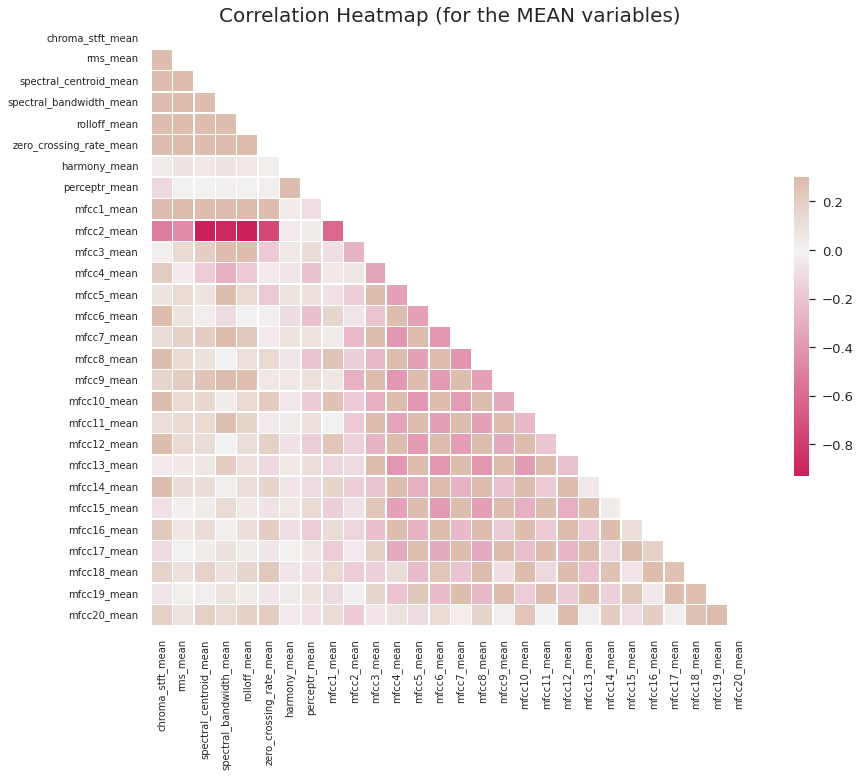

In [175]:
# Computing the Correlation Matrix
spike_cols = [col for col in df.columns if 'mean' in col]
corr = df[spike_cols].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(16, 11));

# Generate a custom diverging colormap
cmap = sns.diverging_palette(0, 25, as_cmap=True, s = 90, l = 45, n = 5)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.title('Correlation Heatmap (for the MEAN variables)', fontsize = 20)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10);

From the above image we can find the correlation between all features in our dataset.

##**BOX PLOT**

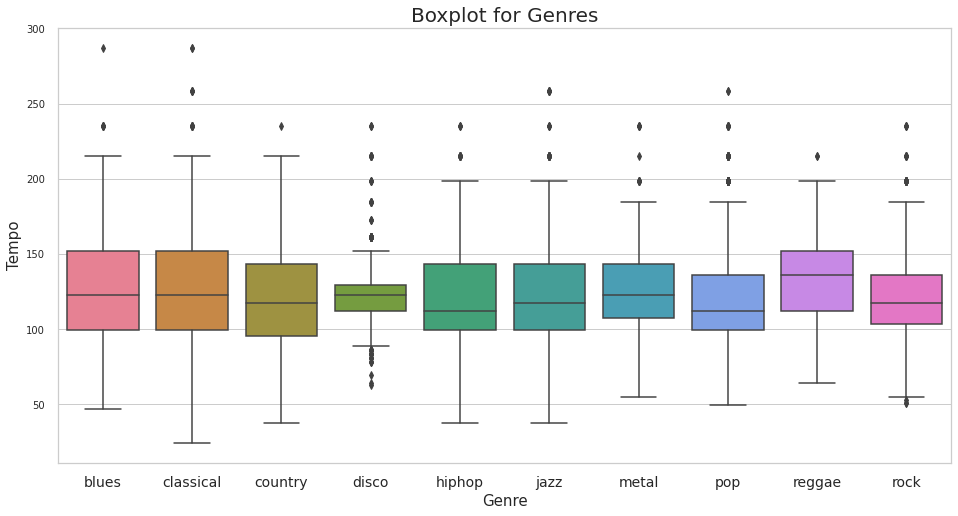

In [176]:
x = df[["label", "tempo"]]

fig, ax = plt.subplots(figsize=(16, 8));
sns.boxplot(x = "label", y = "tempo", data = x, palette = 'husl');

plt.title('Boxplot for Genres', fontsize = 20)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10);
plt.xlabel("Genre", fontsize = 15)
plt.ylabel("Tempo", fontsize = 15)
plt.savefig("Boxplot.png")

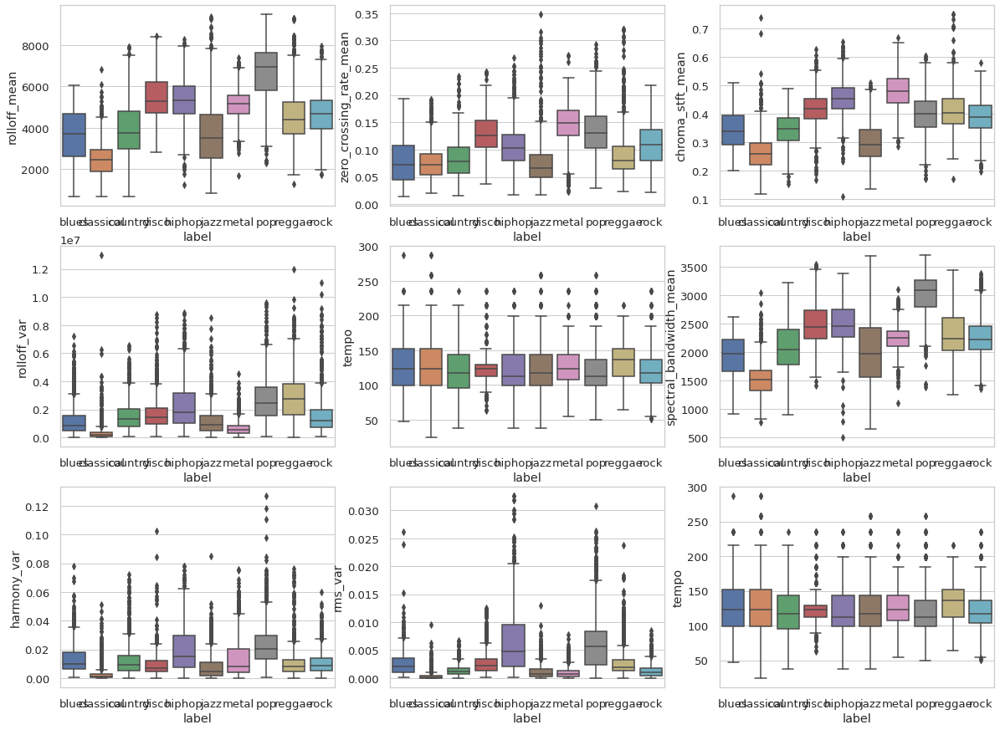

In [177]:
sns.set(style="whitegrid", font_scale=1.2)
plt.subplots(figsize = (20,15))
plt.subplot(3,3,1)
sns.boxplot(x='label',y='rolloff_mean',data=df)
plt.subplot(3,3,2)
sns.boxplot(x="label",y='zero_crossing_rate_mean',data=df)
plt.subplot(3,3,3)
sns.boxplot(x="label",y='chroma_stft_mean',data=df)
plt.subplot(3,3,4)
sns.boxplot(x="label",y= 'rolloff_var',data=df)
plt.subplot(3,3,5)
sns.boxplot(x="label",y='tempo', data=df)
plt.subplot(3,3,6)
sns.boxplot(x="label",y='spectral_bandwidth_mean', data=df)
plt.subplot(3,3,7)
sns.boxplot(x="label",y='harmony_var', data=df)
plt.subplot(3,3,8)
sns.boxplot(x="label",y='rms_var', data=df)
plt.subplot(3,3,9)
sns.boxplot(x="label",y='tempo', data=df)

plt.show()

From the above image we can visualize outliers in our dataset.

##**PAIR PLOT**

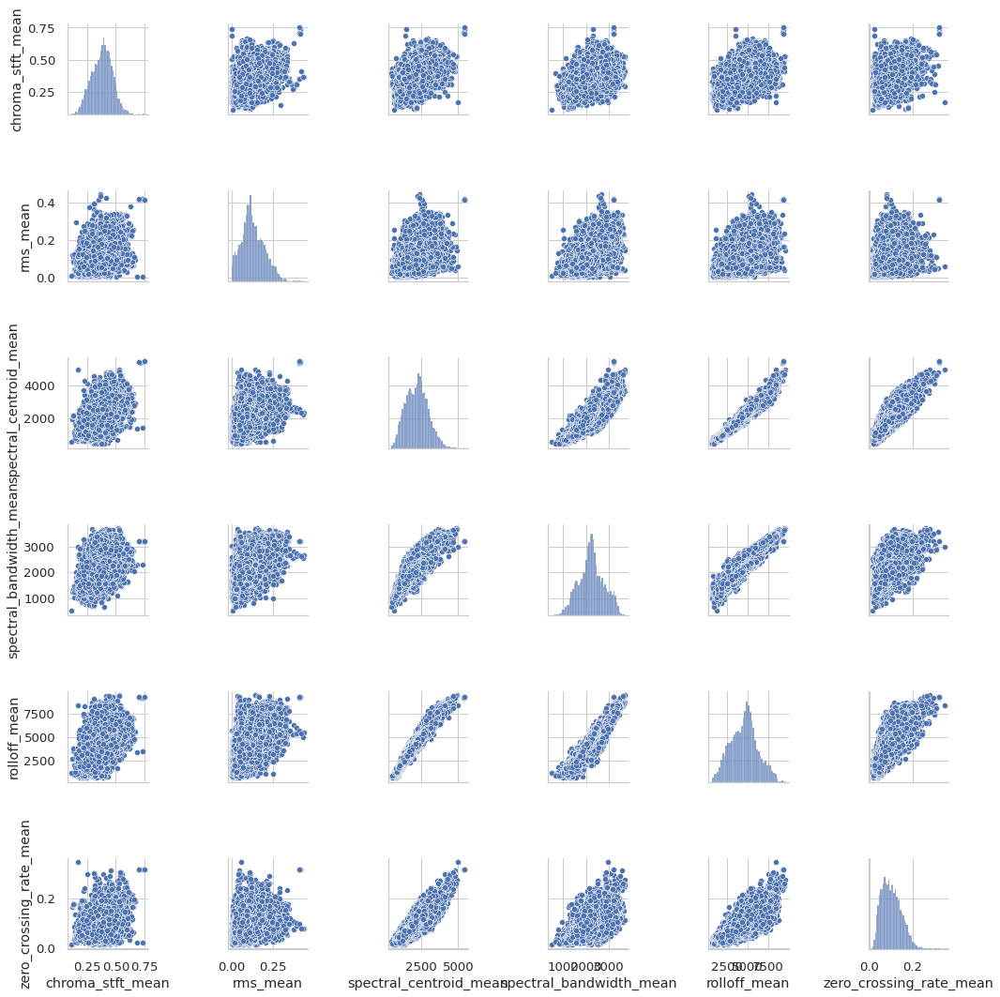

In [178]:
sns.pairplot(data = df, vars=['chroma_stft_mean', 'rms_mean','spectral_centroid_mean', 
       'spectral_bandwidth_mean', 'rolloff_mean','zero_crossing_rate_mean'])
plt.show()

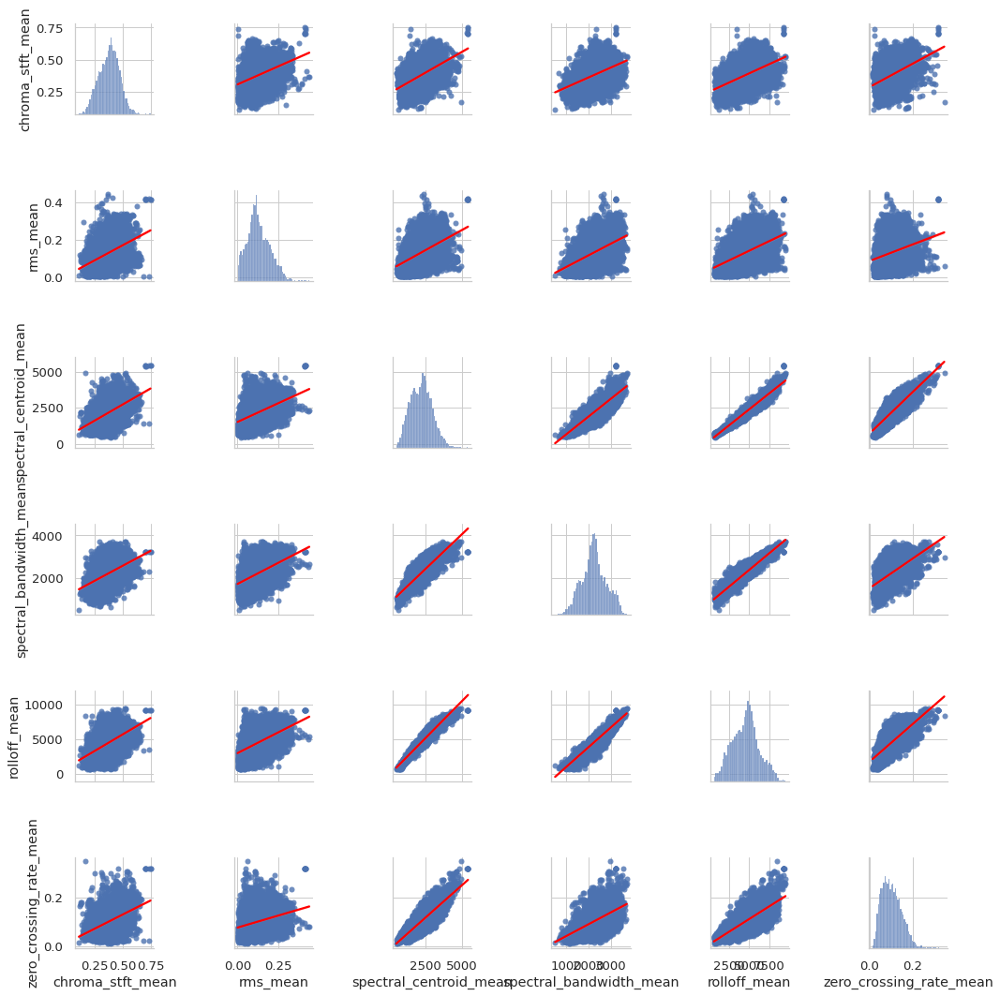

In [179]:
sns.pairplot(data = df, vars=['chroma_stft_mean', 'rms_mean','spectral_centroid_mean', 
       'spectral_bandwidth_mean', 'rolloff_mean','zero_crossing_rate_mean'], kind="reg", plot_kws={'line_kws':{'color':'red'}})
plt.show()

##**HISTOGRAM**

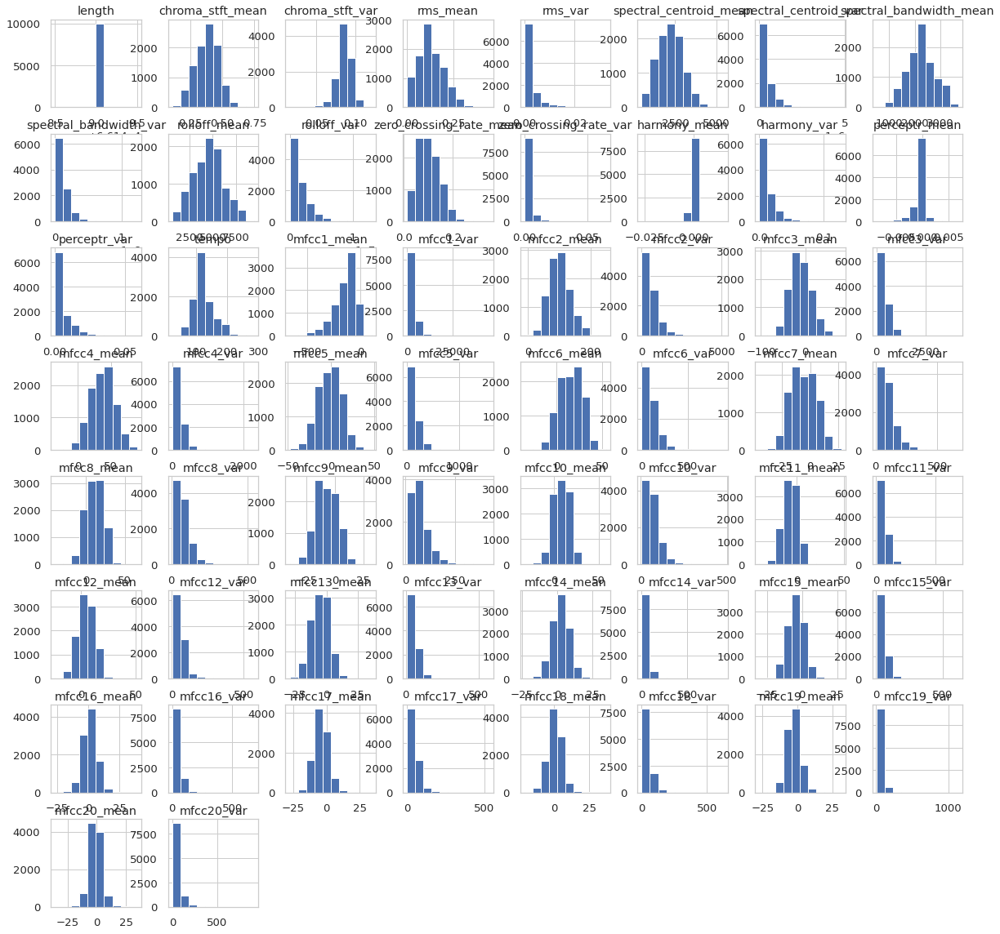

In [180]:
df1=df.drop("label",axis=1)
df1.hist(figsize = (20, 20))
plt.show()

#**DATA PREPROCESSING**



> Labels to integers



In [181]:
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()
df['label'] = label_encoder.fit_transform(df['label'])

In [182]:
X = df.drop(['label','filename'],axis=1)
y = df['label'] 




**DATA NORMALIZATION**





In [183]:
cols = X.columns
min_max_scaler = preprocessing.MinMaxScaler()
np_scaled = min_max_scaler.fit_transform(X)

# new data frame with the new scaled data. 
X = pd.DataFrame(np_scaled, columns = cols)

# **TRAIN TEST SPLIT**

In [184]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=111)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((6693, 58), (3297, 58), (6693,), (3297,))

# **MODELS**

In [185]:
def model_assess(model, title = "Default"):
    model.fit(X_train, y_train)
    preds = model.predict(X_test)
    confus_mat = confusion_matrix(y_test, preds) 
    plt.figure(figsize = (10, 5))
    sns.heatmap(confus_mat)
    print(classification_report(y_test, preds))
    print('ACCURACY :', title, ':', round(accuracy_score(y_test, preds), 5), '\n')

##**1.LOGISTIC REGRESSION**

              precision    recall  f1-score   support

           0       0.62      0.72      0.67       293
           1       0.87      0.93      0.90       322
           2       0.64      0.59      0.62       339
           3       0.58      0.51      0.54       341
           4       0.65      0.60      0.62       317
           5       0.76      0.76      0.76       329
           6       0.78      0.85      0.81       355
           7       0.75      0.81      0.78       356
           8       0.69      0.62      0.65       336
           9       0.47      0.46      0.46       309

    accuracy                           0.69      3297
   macro avg       0.68      0.69      0.68      3297
weighted avg       0.68      0.69      0.68      3297

ACCURACY : Logistic Regression : 0.68759 



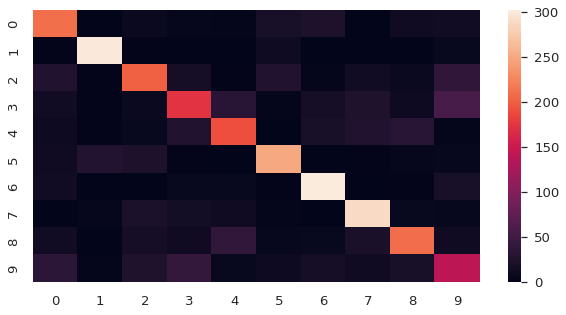

In [187]:
# Logistic Regression
lg = LogisticRegression(random_state=0, solver='lbfgs', multi_class='multinomial',max_iter=1000)
model_assess(lg, "Logistic Regression")

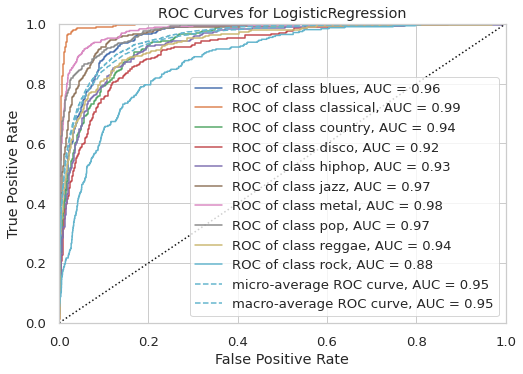

In [188]:
visualizer = ROCAUC(lg, classes=['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz','metal', 'pop', 'reggae', 'rock'])
visualizer.fit(X_train, y_train) 
visualizer.score(X_test, y_test) 
visualizer.show() 

##**2.NAIVE BAYES**

              precision    recall  f1-score   support

           0       0.49      0.29      0.37       293
           1       0.76      0.90      0.83       322
           2       0.41      0.61      0.49       339
           3       0.38      0.34      0.36       341
           4       0.59      0.30      0.40       317
           5       0.69      0.39      0.50       329
           6       0.50      0.88      0.63       355
           7       0.62      0.73      0.67       356
           8       0.54      0.45      0.49       336
           9       0.27      0.23      0.25       309

    accuracy                           0.52      3297
   macro avg       0.53      0.51      0.50      3297
weighted avg       0.53      0.52      0.50      3297

ACCURACY : Naive Bayes : 0.52047 



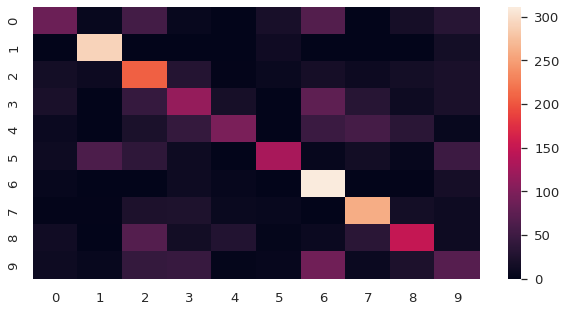

In [189]:
# Naive Bayes
nb = GaussianNB()
model_assess(nb, "Naive Bayes")

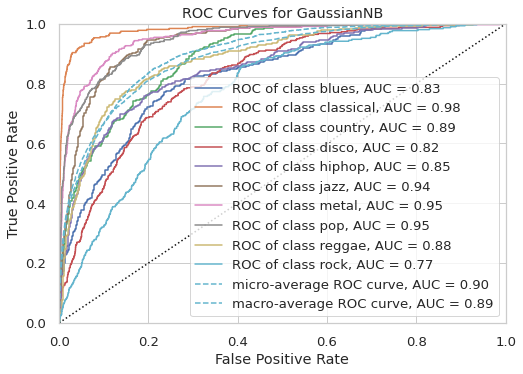

In [190]:
visualizer = ROCAUC(nb, classes=['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz','metal', 'pop', 'reggae', 'rock'])
visualizer.fit(X_train, y_train) 
visualizer.score(X_test, y_test) 
visualizer.show() 

##**3.DECISION TREE**

              precision    recall  f1-score   support

           0       0.61      0.64      0.62       293
           1       0.85      0.88      0.87       322
           2       0.53      0.50      0.51       339
           3       0.58      0.52      0.55       341
           4       0.60      0.62      0.61       317
           5       0.67      0.68      0.68       329
           6       0.79      0.74      0.77       355
           7       0.68      0.70      0.69       356
           8       0.65      0.63      0.64       336
           9       0.48      0.52      0.50       309

    accuracy                           0.64      3297
   macro avg       0.64      0.64      0.64      3297
weighted avg       0.65      0.64      0.64      3297

ACCURACY : Decission trees : 0.64483 



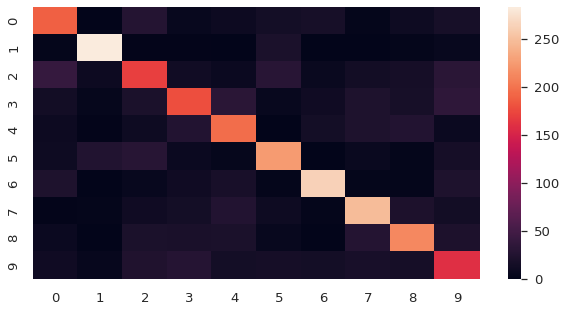

In [191]:
# Decission trees
tree = DecisionTreeClassifier()
model_assess(tree, "Decission trees")

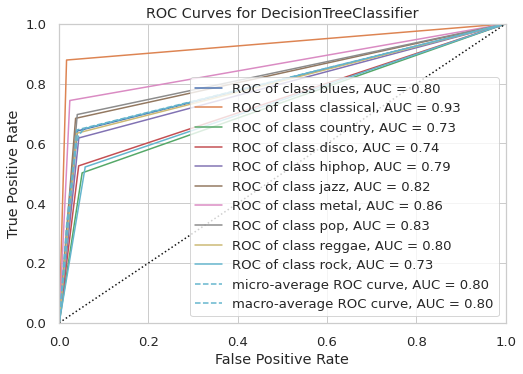

In [192]:
visualizer = ROCAUC(tree, classes=['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz',
       'metal', 'pop', 'reggae', 'rock'])
visualizer.fit(X_train, y_train) 
visualizer.score(X_test, y_test) 
visualizer.show() 

##**4.SVM**

              precision    recall  f1-score   support

           0       0.70      0.81      0.75       293
           1       0.88      0.95      0.92       322
           2       0.73      0.69      0.71       339
           3       0.60      0.64      0.62       341
           4       0.72      0.65      0.68       317
           5       0.81      0.80      0.81       329
           6       0.84      0.85      0.85       355
           7       0.83      0.81      0.82       356
           8       0.76      0.70      0.73       336
           9       0.53      0.51      0.52       309

    accuracy                           0.74      3297
   macro avg       0.74      0.74      0.74      3297
weighted avg       0.74      0.74      0.74      3297

ACCURACY : Support Vector Machine : 0.7434 



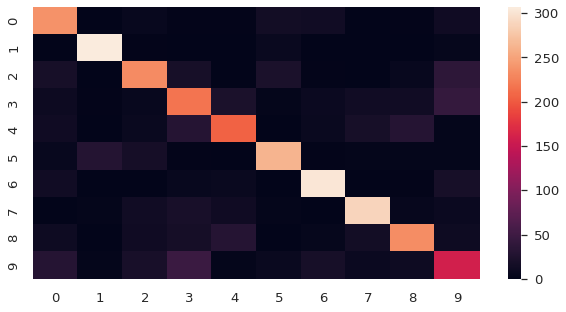

In [193]:
# Support Vector Machine
svm = SVC(decision_function_shape="ovo") #ovo=one vs one
model_assess(svm, "Support Vector Machine")

LINEAR KERNEL

              precision    recall  f1-score   support

           0       0.64      0.80      0.71       293
           1       0.88      0.93      0.90       322
           2       0.67      0.65      0.66       339
           3       0.58      0.56      0.57       341
           4       0.69      0.68      0.68       317
           5       0.79      0.78      0.79       329
           6       0.83      0.83      0.83       355
           7       0.80      0.81      0.80       356
           8       0.76      0.63      0.69       336
           9       0.50      0.49      0.49       309

    accuracy                           0.72      3297
   macro avg       0.71      0.72      0.71      3297
weighted avg       0.72      0.72      0.72      3297

ACCURACY : Support Vector Machine : 0.71732 



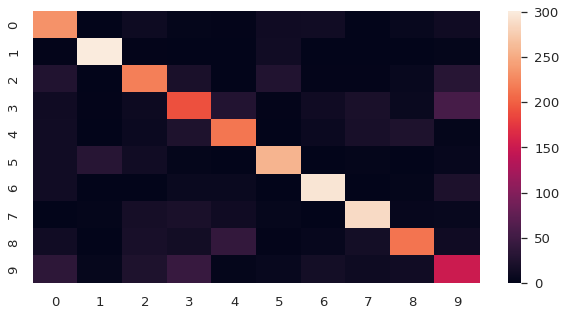

In [194]:
svm = SVC(decision_function_shape="ovo",kernel='linear') #ovo=one vs one
model_assess(svm, "Support Vector Machine")

POLYNOMIAL KERNEL

              precision    recall  f1-score   support

           0       0.78      0.86      0.82       293
           1       0.88      0.96      0.92       322
           2       0.75      0.73      0.74       339
           3       0.71      0.71      0.71       341
           4       0.78      0.76      0.77       317
           5       0.85      0.85      0.85       329
           6       0.90      0.87      0.89       355
           7       0.86      0.84      0.85       356
           8       0.83      0.74      0.78       336
           9       0.60      0.62      0.61       309

    accuracy                           0.80      3297
   macro avg       0.79      0.80      0.79      3297
weighted avg       0.80      0.80      0.80      3297

ACCURACY : Support Vector Machine : 0.79588 



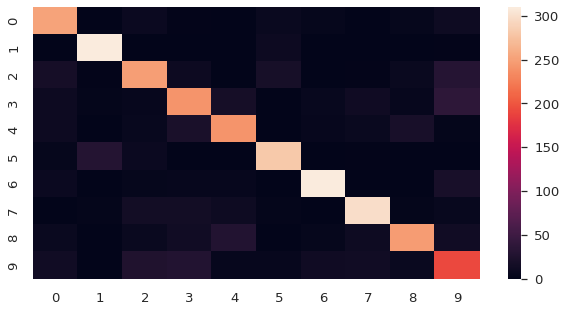

In [195]:
svm = SVC(decision_function_shape="ovo",kernel='poly') #ovo=one vs one
model_assess(svm, "Support Vector Machine")

##**5.KNN**

              precision    recall  f1-score   support

           0       0.87      0.83      0.85       293
           1       0.84      0.94      0.89       322
           2       0.73      0.81      0.77       339
           3       0.65      0.85      0.74       341
           4       0.84      0.71      0.77       317
           5       0.83      0.77      0.80       329
           6       0.95      0.82      0.88       355
           7       0.90      0.77      0.83       356
           8       0.75      0.80      0.77       336
           9       0.73      0.69      0.71       309

    accuracy                           0.80      3297
   macro avg       0.81      0.80      0.80      3297
weighted avg       0.81      0.80      0.80      3297

ACCURACY : KNN : 0.79921 



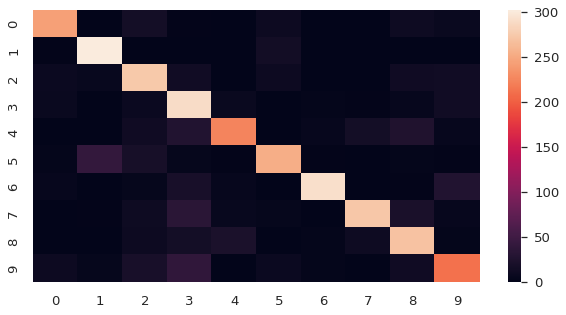

In [196]:
# KNN
knn = KNeighborsClassifier(n_neighbors=19)
model_assess(knn, "KNN")

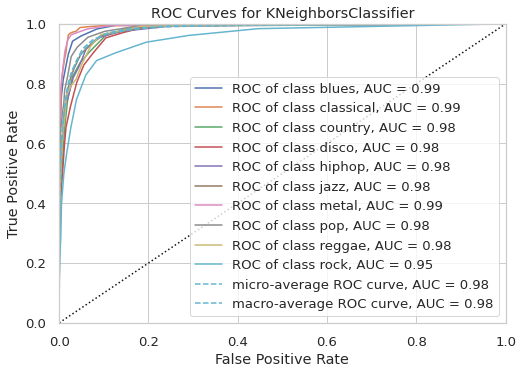

In [197]:
visualizer = ROCAUC(knn, classes=['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz',
       'metal', 'pop', 'reggae', 'rock'])
visualizer.fit(X_train, y_train) 
visualizer.score(X_test, y_test) 
visualizer.show() 

##**6.RANDOM FOREST CLASSIFIER**

              precision    recall  f1-score   support

           0       0.83      0.86      0.85       293
           1       0.91      0.97      0.94       322
           2       0.74      0.76      0.75       339
           3       0.69      0.70      0.69       341
           4       0.84      0.78      0.81       317
           5       0.83      0.86      0.84       329
           6       0.86      0.91      0.89       355
           7       0.89      0.81      0.85       356
           8       0.77      0.81      0.79       336
           9       0.74      0.64      0.69       309

    accuracy                           0.81      3297
   macro avg       0.81      0.81      0.81      3297
weighted avg       0.81      0.81      0.81      3297

ACCURACY : Random Forest : 0.81104 



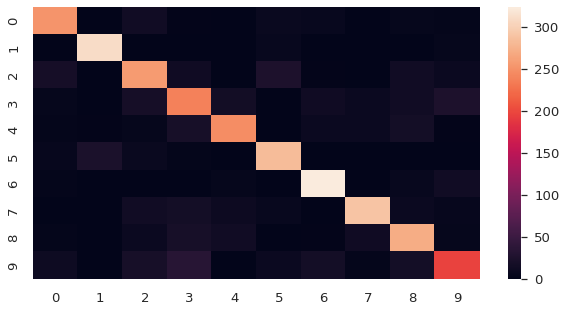

In [198]:
# Random Forest
rforest = RandomForestClassifier(n_estimators=1000, max_depth=10, random_state=0)
model_assess(rforest, "Random Forest")

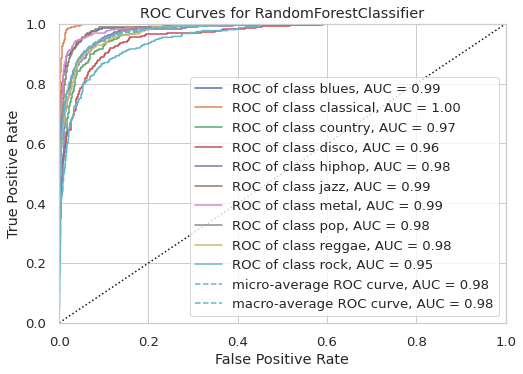

In [199]:
visualizer = ROCAUC(rforest, classes=['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz',
       'metal', 'pop', 'reggae', 'rock'])
visualizer.fit(X_train, y_train) 
visualizer.score(X_test, y_test) 
visualizer.show() 

##**7.CATBOOST**

              precision    recall  f1-score   support

           0       0.90      0.94      0.92       293
           1       0.94      0.98      0.96       322
           2       0.87      0.89      0.88       339
           3       0.88      0.85      0.86       341
           4       0.90      0.92      0.91       317
           5       0.90      0.91      0.91       329
           6       0.95      0.93      0.94       355
           7       0.92      0.90      0.91       356
           8       0.93      0.89      0.91       336
           9       0.85      0.83      0.84       309

    accuracy                           0.90      3297
   macro avg       0.90      0.90      0.90      3297
weighted avg       0.90      0.90      0.90      3297

ACCURACY : Cat Boost Classifier : 0.90355 



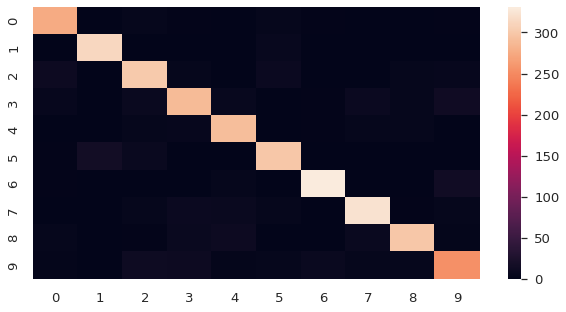

In [200]:
# catboost
cbc = cb.CatBoostClassifier(verbose=0, eval_metric='Accuracy', loss_function='MultiClass')
model_assess(cbc,"Cat Boost Classifier")

So we got highest accuracy with catboost model.Let's print the confusion matrix of it

#**BEST MODEL :**

Accuracy : 0.90355 



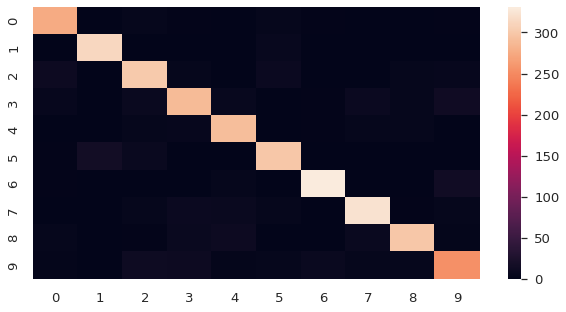

In [201]:
# Final model
cbc = cb.CatBoostClassifier(verbose=0, eval_metric='Accuracy', loss_function='MultiClass')
cbc.fit(X_train, y_train)


preds = cbc.predict(X_test)

print('Accuracy', ':', round(accuracy_score(y_test, preds), 5), '\n')

# Confusion Matrix
confus_mat = confusion_matrix(y_test, preds) 
plt.figure(figsize = (10, 5))
sns.heatmap(confus_mat)

#**SUMMARY :**

**Accuracies of above Models :**
------------------------------------------------
*   Naive Bayes - 0.52
*   Decision Trees - 0.64
*   Logistic Regression - 0.69
*   Linear SVM - 0.72
*   RBF SVM - 0.74
*   Polynomial SVM - 0.79
*   KNN - 0.80
*   Random Forest - 0.81
*   CatBoost - 0.90

From the observed accuracies we can choose CatBoost as our best model that classifies Music Genres. 








# MUSIC GENRE RECOMMENDATION SYSTEM
"Recomender" System enable us for any given vector to find the best similarity, ranked in descending order, from the bast match to the least best match. 

For Audio files, this will be done through `cosine_similarity` library.

In [202]:
data = pd.read_csv(f'{path}/features_30_sec.csv', index_col='filename')
labels = data[['label']]
data = data.drop(columns=['length','label'])
data.head()
data_scaled=preprocessing.scale(data)
print('Scaled data type:', type(data_scaled))

Scaled data type: <class 'numpy.ndarray'>


### COSINE SIMILARITY

Calculates the *pairwise cosine similarity* for each combination of songs in the data. This results in a 1000 x 1000 matrix (with redundancy in the information as item A similarity to item B == item B similarity to item A).

In [203]:
similarity = cosine_similarity(data_scaled)
print("Similarity shape:", similarity.shape)
sim_df_labels = pd.DataFrame(similarity)
sim_df_names = sim_df_labels.set_index(labels.index)
sim_df_names.columns = labels.index

sim_df_names.head()

Similarity shape: (1000, 1000)


filename,blues.00000.wav,blues.00001.wav,blues.00002.wav,blues.00003.wav,blues.00004.wav,blues.00005.wav,blues.00006.wav,blues.00007.wav,blues.00008.wav,blues.00009.wav,blues.00010.wav,blues.00011.wav,blues.00012.wav,blues.00013.wav,blues.00014.wav,blues.00015.wav,blues.00016.wav,blues.00017.wav,blues.00018.wav,blues.00019.wav,blues.00020.wav,blues.00021.wav,blues.00022.wav,blues.00023.wav,blues.00024.wav,blues.00025.wav,blues.00026.wav,blues.00027.wav,blues.00028.wav,blues.00029.wav,blues.00030.wav,blues.00031.wav,blues.00032.wav,blues.00033.wav,blues.00034.wav,blues.00035.wav,blues.00036.wav,blues.00037.wav,blues.00038.wav,blues.00039.wav,...,rock.00060.wav,rock.00061.wav,rock.00062.wav,rock.00063.wav,rock.00064.wav,rock.00065.wav,rock.00066.wav,rock.00067.wav,rock.00068.wav,rock.00069.wav,rock.00070.wav,rock.00071.wav,rock.00072.wav,rock.00073.wav,rock.00074.wav,rock.00075.wav,rock.00076.wav,rock.00077.wav,rock.00078.wav,rock.00079.wav,rock.00080.wav,rock.00081.wav,rock.00082.wav,rock.00083.wav,rock.00084.wav,rock.00085.wav,rock.00086.wav,rock.00087.wav,rock.00088.wav,rock.00089.wav,rock.00090.wav,rock.00091.wav,rock.00092.wav,rock.00093.wav,rock.00094.wav,rock.00095.wav,rock.00096.wav,rock.00097.wav,rock.00098.wav,rock.00099.wav
filename,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
blues.00000.wav,1.000000,0.049231,0.589618,0.284862,0.025561,-0.346688,-0.219483,-0.167626,0.641877,-0.097889,-0.004725,-0.138701,0.022420,0.170770,-0.100287,-0.061984,0.038424,0.070591,-0.043250,-0.032994,0.506165,-0.103861,-0.153357,-0.021814,-0.068566,-0.103846,-0.286219,-0.017917,0.019182,-0.245793,-0.158164,-0.203505,-0.238364,-0.245459,-0.182820,0.016867,-0.108189,-0.377991,-0.102337,-0.288664,...,-0.180951,-0.357947,-0.499987,-0.583565,0.582948,0.455372,-0.117475,0.291773,0.535460,0.111680,-0.018038,0.616646,0.616184,0.619470,0.737537,0.391488,0.386102,0.524411,0.383944,0.635159,0.483003,0.338310,0.341182,0.704877,0.468150,-0.165756,-0.033461,0.655153,0.271846,0.484170,-0.082829,0.546169,0.578558,0.662590,0.571629,0.610942,0.640835,0.496294,0.284958,0.304098
blues.00001.wav,0.049231,1.000000,-0.096834,0.520903,0.080749,0.307856,0.318286,0.415258,0.120649,0.404168,0.187969,0.537564,0.116593,0.138999,0.372891,0.339293,0.243391,0.293110,0.242766,0.350323,0.173128,0.374270,0.433072,0.041210,0.293562,0.208121,0.265333,0.069686,0.193576,0.315657,0.197519,0.174806,0.336295,0.264876,0.151645,0.155828,0.129249,0.296153,0.236439,0.296356,...,-0.292708,0.038637,-0.141359,0.418910,-0.177155,-0.108917,0.554469,0.031773,-0.153006,0.026416,-0.086265,-0.040695,-0.088279,-0.219520,-0.169743,0.043461,0.234076,-0.143892,0.226681,-0.234705,-0.254766,0.087614,-0.204128,-0.241611,-0.207278,0.031050,0.220761,-0.295174,-0.133969,0.047796,-0.098111,-0.325126,-0.370792,-0.191698,-0.330834,-0.077301,-0.222119,-0.302573,0.499562,0.311723
blues.00002.wav,0.589618,-0.096834,1.000000,0.210411,0.400266,-0.082019,-0.028061,0.104446,0.468113,-0.132532,0.220436,0.057667,0.214217,0.026326,-0.174039,-0.091717,0.042537,0.056512,-0.294934,0.037617,0.287231,-0.181328,-0.235117,0.129427,-0.020690,-0.191341,-0.372636,-0.058686,0.120372,0.075361,0.216751,0.196171,0.082313,0.175337,0.256547,0.392760,0.325772,-0.130494,0.242670,0.045100,...,-0.386603,-0.475932,-0.462687,-0.531435,0.657971,0.434122,-0.034768,0.271837,0.451977,0.175507,0.234224,0.450491,0.417995,0.488881,0.503598,0.348458,0.357615,0.455360,0.404612,0.631893,0.443831,0.326861,0.241868,0.550154,0.420591,0.109318,0.109191,0.594156,0.192450,0.566140,-0.032408,0.561074,0.590779,0.583293,0.514537,0.495707,0.566837,0.589983,0.216378,0.321069
blues.00003.wav,0.284862,0.520903,0.210411,1.000000,0.126437,0.134796,0.300746,0.324566,0.352758,0.295184,0.339783,0.414037,0.103369,0.220996,0.224956,0.228406,0.042363,0.261825,0.065738,0.303616,0.225934,0.248292,0.260467,0.101586,0.330638,0.255722,0.167251,0.160013,0.378844,0.163240,0.115658,0.078846,0.199018,0.076584,0.028351,0.183075,0.142251,0.039

`find_similar_songs()` - is a predefined function that takes the name of the song and returns top 5 best matches for that song.

In [204]:
def find_similar_songs(name):
    series = sim_df_names[name].sort_values(ascending = False)
    series = series.drop(name)
    print("\n*******\nSimilar songs to ", name)
    print(series.head(5))

### POP Example

In [205]:
# pop.00019 - Britney Spears "Hit me baby one more time"
find_similar_songs('pop.00019.wav') 
ipd.Audio(f'{path}/genres_original/pop/pop.00019.wav')


*******
Similar songs to  pop.00019.wav
filename
pop.00023.wav    0.862836
pop.00034.wav    0.860499
pop.00078.wav    0.829135
pop.00088.wav    0.824456
pop.00091.wav    0.802269
Name: pop.00019.wav, dtype: float64


#### Similar song match no.1 
*Britney Spears* - **I'm so curious (2009 remaster)**

In [206]:
ipd.Audio(f'{path}/genres_original/pop/pop.00023.wav')

#### Similar song match no.2
*Britney Spears* - **Sometimes**

In [207]:
ipd.Audio(f'{path}/genres_original/pop/pop.00034.wav')

### METAL Example

In [208]:
# metal.00002 - Iron Maiden "Flight of Icarus"
find_similar_songs('metal.00002.wav') 
ipd.Audio(f'{path}/genres_original/metal/metal.00002.wav')


*******
Similar songs to  metal.00002.wav
filename
metal.00028.wav    0.904367
metal.00059.wav    0.896096
rock.00018.wav     0.891910
rock.00017.wav     0.886526
rock.00016.wav     0.867508
Name: metal.00002.wav, dtype: float64


#### Similar song match no.1 
*Motorhead* - **Ace of Spades**

In [209]:
ipd.Audio(f'{path}/genres_original/metal/metal.00028.wav')

#### Similar song match no.2
*Queen* - **Tear it Up**

In [210]:
ipd.Audio(f'{path}/genres_original/metal/metal.00059.wav')